# TODOs:
- when plotting images, plot degraded images
- get 0.3 resolution trained

In [1]:
BASE_RES = 1

In [2]:
from keras.applications.resnet50 import ResNet50, preprocess_input
from keras.models import Model
from keras.preprocessing import image
from keras import models
from keras import layers
from keras import optimizers
from keras.models import model_from_json

/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [3]:
from matplotlib import pyplot as plt
%matplotlib inline

import numpy as np
import pandas as pd
import sys
import os
import random

from PIL import Image

from dotenv import load_dotenv

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [4]:
sys.path.append("../Library/")
import deep_learning as dl
import image_manipulation as ima
import machine_learning as ml
import present_results as pr

In [5]:
%load_ext autoreload
%autoreload 2

In [6]:
PATH_GDRIVE = os.getenv('GDRIVE_FOLDER')
PATH_RESULTS = os.path.join(PATH_GDRIVE.replace("MDS/","") , 'COLAB/MasterThesis/Results_' + str(BASE_RES) + 'm_excl_label1')

In [7]:
base_res = BASE_RES
base_size = 512
N_RES = 17

sizes = {base_res: (base_size, base_size)}
for factor in range(2, N_RES):
    res = round(base_res * factor,1)
    size = round(base_size/factor)
    sizes[res] = (size, size)
print("Sizes dictionary:\n", sizes)

Sizes dictionary:
 {1: (512, 512), 2: (256, 256), 3: (171, 171), 4: (128, 128), 5: (102, 102), 6: (85, 85), 7: (73, 73), 8: (64, 64), 9: (57, 57), 10: (51, 51), 11: (47, 47), 12: (43, 43), 13: (39, 39), 14: (37, 37), 15: (34, 34), 16: (32, 32)}


### Load Images that were used to train the model

In [8]:
X = np.load(os.path.join(PATH_RESULTS, "X_images_res" + str(BASE_RES) + ".npy"))
y = np.load(os.path.join(PATH_RESULTS, "y_images_res" + str(BASE_RES) + ".npy"))

### Load DataFrames with Results of Cross-validation

In [9]:
count = 0
for file in os.listdir(PATH_RESULTS):
    if file.startswith('result') and count == 0:
        df_results = pd.read_csv(os.path.join(PATH_RESULTS, file), )
        count += 1
    elif file.startswith('result') and count > 0:
        df_results = df_results.append(pd.read_csv(os.path.join(PATH_RESULTS, file)))
        count += 1

# Accuracy vs Resolution

In [12]:
mask = df_results["accuracy"] > 0.6
df_results = df_results[mask]

In [13]:
grouped_results = df_results.groupby(['resolution'], as_index=False).agg(
                          {'accuracy':['mean','std']})

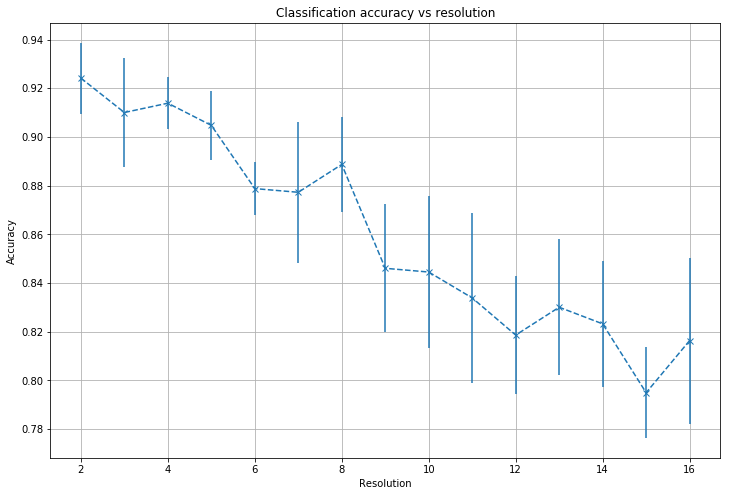

In [14]:
fig, ax = plt.subplots()
fig.set_size_inches(12,8)

ax.errorbar(grouped_results["resolution"], 
            grouped_results.accuracy["mean"], 
            grouped_results.accuracy["std"],
            linestyle='dashed', marker='x'
           )  
ax.set(
    xlabel="Resolution",
    ylabel="Accuracy",
    title = "Classification accuracy vs resolution"
)
ax.grid()

plt.show()

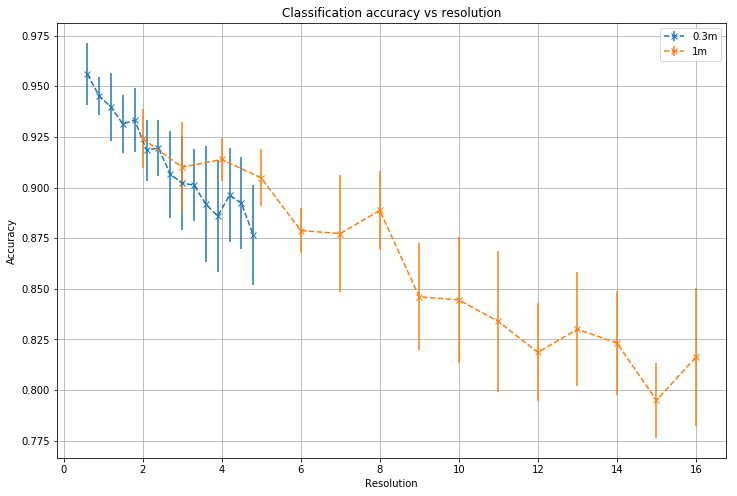

In [16]:
ACC_THRESHOLD = 0.6
RES_RESULTS = [0.3, 1]

fig, ax = plt.subplots()
fig.set_size_inches(12,8)

for res in RES_RESULTS:
    PATH_RESULTS = os.path.join(PATH_GDRIVE.replace("MDS/","") , 'COLAB/MasterThesis/Results_' + str(res) + 'm_excl_label1')
    
    count = 0
    for file in os.listdir(PATH_RESULTS):
        if file.startswith('result') and count == 0:
            df_results = pd.read_csv(os.path.join(PATH_RESULTS, file), )
            count += 1
        elif file.startswith('result') and count > 0:
            df_results = df_results.append(pd.read_csv(os.path.join(PATH_RESULTS, file)))
            count += 1
    
    df_results = df_results[df_results["accuracy"] > ACC_THRESHOLD]
    grouped_results = df_results.groupby(['resolution'], as_index=False).agg({'accuracy':['mean','std']})
    
    ax.errorbar(
        grouped_results["resolution"], grouped_results.accuracy["mean"], grouped_results.accuracy["std"],
        linestyle='dashed', marker='x', label=str(res)+"m"
    )  

ax.set(
    xlabel="Resolution",
    ylabel="Accuracy",
    title = "Classification accuracy vs resolution"
)
ax.grid()
ax.legend()

plt.show()

# Correctly Classified Images at Resolution 2

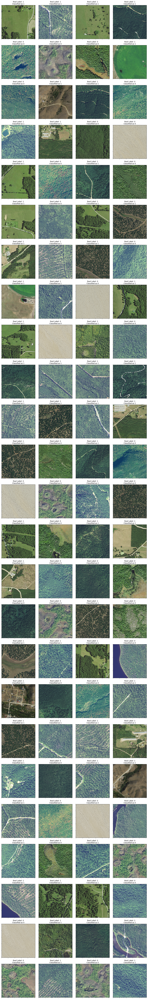

In [19]:
res = 2

X_correct_class, y_real_label, _ = pr.get_misclf_or_correctclf_images(X, 
                                                                    y, 
                                                                    df_results, 
                                                                    res = res, 
                                                                    n = 100, 
                                                                    misclf = False)
pr.plot_misclf_or_correctclf_images(X_correct_class, 
                                  y_real_label, 
                                  columns = 4,
                                  misclf = False,
                                  degrade = sizes[res])

# Wrongly Classified Images at Resolution 2

/anaconda3/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


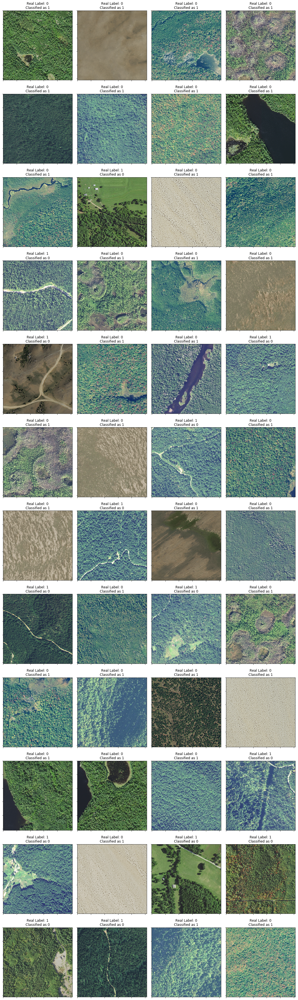

In [21]:
res = 2

X_wrong_class, y_real_label, _ = pr.get_misclf_or_correctclf_images(X, 
                                                                  y, 
                                                                  df_results, 
                                                                  res = res, 
                                                                  n = 50, 
                                                                  misclf = True)
pr.plot_misclf_or_correctclf_images(X_wrong_class, 
                                  y_real_label,
                                  columns = 4,
                                  misclf = True,
                                  degrade = sizes[res])

# Correctly Classified Images at Resolution 4.8

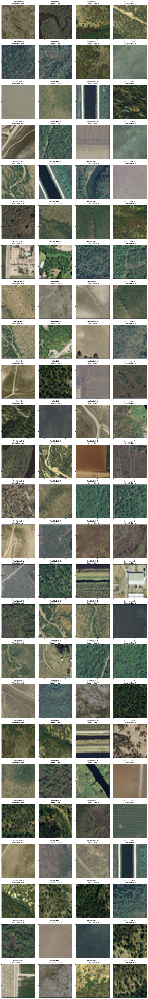

In [96]:
res = 4.8

X_correct_class, y_real_label, _ = pr.get_misclf_or_correctclf_images(X, 
                                                                    y, 
                                                                    df_results, 
                                                                    res = res, 
                                                                    n = 100, 
                                                                    misclf = False)
pr.plot_misclf_or_correctclf_images(X_correct_class, 
                                  y_real_label, 
                                  columns = 4,
                                  misclf = False,
                                  degrade = sizes[res])

# Wrongly Classified Images at Resolution 0.6

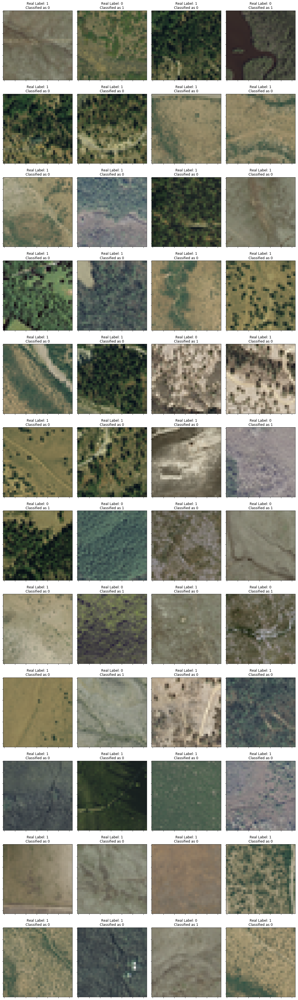

In [97]:
res = 4.8

X_wrong_class, y_real_label, _ = pr.get_misclf_or_correctclf_images(X, 
                                                                  y, 
                                                                  df_results, 
                                                                  res = res, 
                                                                  n = 50, 
                                                                  misclf = True)
pr.plot_misclf_or_correctclf_images(X_wrong_class, 
                                  y_real_label,
                                  columns = 4,
                                  misclf = True,
                                  degrade = sizes[res])

# Images that were classified correct at 0.6 and wrong at 4.8

In [106]:
def get_misclf_indcs_outersection(X, y, df_results, res1, res2):

    _, _, high_res_indcs = pr.get_misclf_or_correctclf_images(X,
                                                              y, 
                                                              df_results, 
                                                              res =res1, 
                                                              n = None, 
                                                              misclf = True)

    _, _, low_res_indcs = pr.get_misclf_or_correctclf_images(X,
                                                             y, 
                                                             df_results, 
                                                             res =res2, 
                                                             n = None, 
                                                             misclf = True)
    
    
    high_minus_low = list(set(high_res_indcs) - set(low_res_indcs))
    low_minus_high = list(set(low_res_indcs) - set(high_res_indcs))
    return high_minus_low, low_minus_high

In [107]:
misclf_high, misclf_low = get_misclf_indcs_outersection(X, y, df_results, 0.6, 4.8)

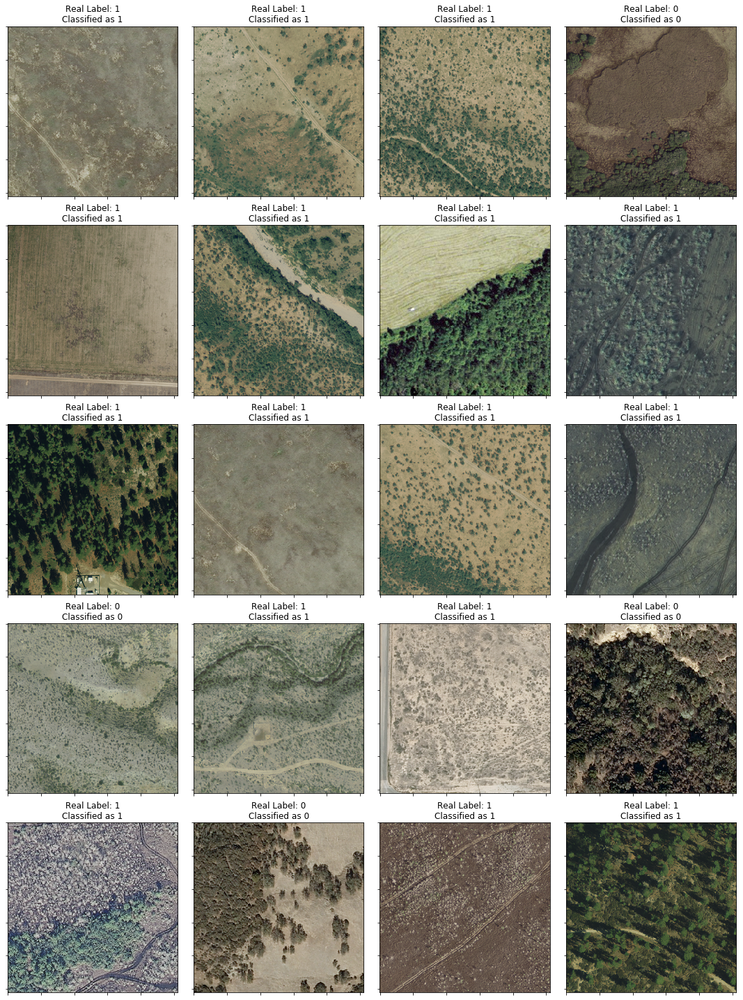

In [108]:
pr.plot_misclf_or_correctclf_images(X[misclf_low], 
                                    y[misclf_low],
                                    n = 20,
                                    columns = 4,
                                    misclf = False,
                                    degrade = sizes[0.6])

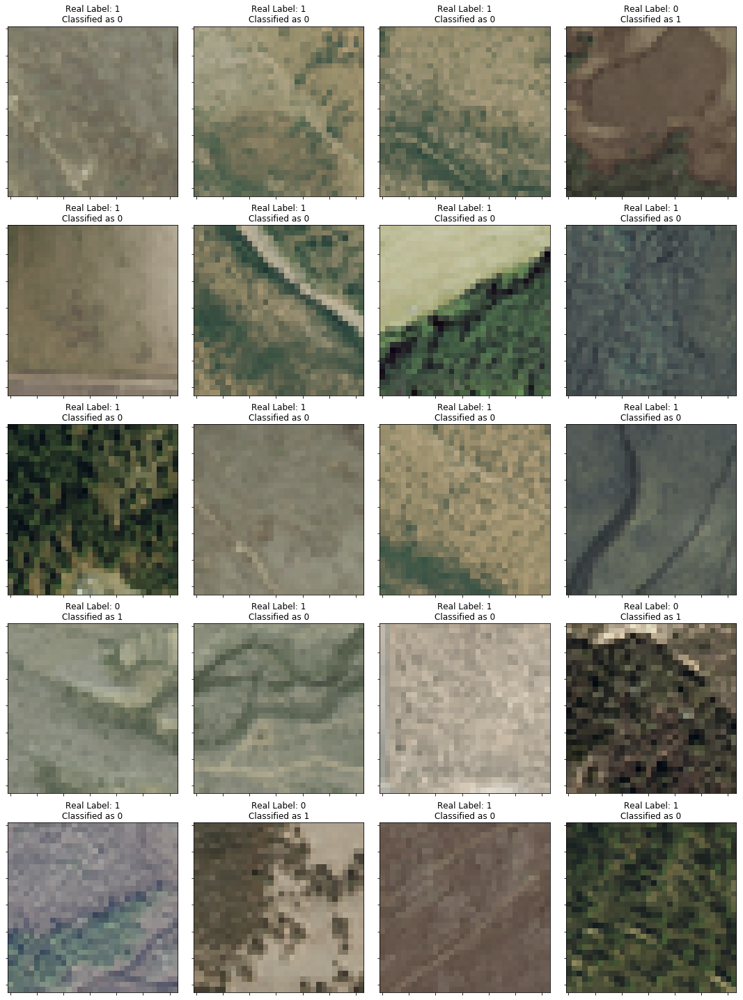

In [109]:
pr.plot_misclf_or_correctclf_images(X[misclf_low], 
                                    y[misclf_low],
                                    n = 20,
                                    columns = 4,
                                    misclf = True,
                                    degrade = sizes[4.8])

# Wrongly classified high resolution vs low resolution (optional)

### TODO: Write explanation here

In [102]:
resolutions = np.linspace(0.6, 4.8, num = 15)
step = 0.3

misclf_high_list = []
misclf_low_list = []
for res in resolutions[1:].round(1):
    misclf_high, misclf_low = get_misclf_indcs_outersection(X, y, df_results, round(res - step,1), res)
    misclf_high_list.append(len(misclf_high))
    misclf_low_list.append(len(misclf_low))

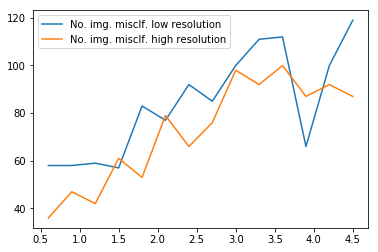

In [103]:
plt.figure()
plt.plot(resolutions[:-1].tolist(), misclf_low_list, label = "No. img. misclf. low resolution")
plt.plot(resolutions[:-1].tolist(), misclf_high_list, label = "No. img. misclf. high resolution")
plt.legend()
plt.show()

### TODO: Write explanation here

In [104]:
resolutions = np.linspace(0.6, 4.8, num = 15)
step = 0.3

misclf_high_list = []
misclf_low_list = []
for res in resolutions[1:].round(1):
    misclf_high, misclf_low = get_misclf_indcs_outersection(X, y, df_results, 0.6, res)
    misclf_high_list.append(len(misclf_high))
    misclf_low_list.append(len(misclf_low))

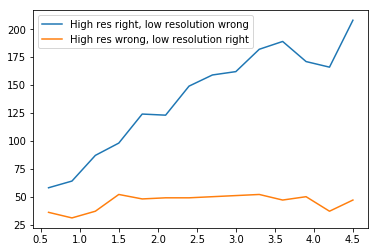

In [105]:
plt.figure()
plt.plot(resolutions[:-1].tolist(), misclf_low_list, label = "High res right, low resolution wrong")
plt.plot(resolutions[:-1].tolist(), misclf_high_list, label = "High res wrong, low resolution right")
plt.legend()
plt.show()

# Classify images of label 1...to continue

In [73]:
X_l1_path = os.path.join(PATH_RESULTS, 'X_l1_images_res0.3.npy')
y_l1_path = os.path.join(PATH_RESULTS, 'y_l1_images_res0.3.npy')

X_l1_base = np.load(X_l1_path)
y_l1_base = np.load(y_l1_path, allow_pickle = True)

In [60]:
base_model50 = ResNet50(weights='imagenet',
                      include_top=False
                     )

In [82]:
#base_model50.summary()

In [83]:
def preprocess_activations(X_base, res, model = base_model50, activation_name = 'conv5_block3_out'):
    print("--- degrading images ---")
    X = np.array([ima.degrade_image(X_base[i], sizes[res]) for i in range(X_base.shape[0])])
    
    print("--- getting activations ---")
    X_act = dl.get_activations(X, model, activation_name)
    
    dim = X_act.shape
    X_act = preprocess_input(X_act)
    X_act_flat = np.reshape(X_act, (dim[0], dim[1] * dim[2] * dim[3]))
    
    return X_act_flat

X_act_flat = preprocess_activations(X_l1_base, 2.4)

--- degrading images ---
--- getting activations ---
Shape of input: (196, 64, 64, 3)
Shape of output: (196, 2, 2, 2048)


In [76]:
dim = X_l1_act.shape

X_l1_act_flat = preprocess_input(X_l1_act)
X_l1_act_flat = np.reshape(X_l1_act_flat, (dim[0], dim[1] * dim[2] * dim[3]))

In [78]:
model_inner[0].predict()

# Deprecated

In [29]:
FOLDS = [0, 1, 2, 3, 4, 5, 6, 7]

RESOLUTIONS = [2.4, 2.7]    

new_models = {}

for res in RESOLUTIONS:

    model_inner = []
    for fold in FOLDS:
        fullpath = os.path.join(PATH_RESULTS, "model_res" + str(res) + "_fold" + str(fold))
        model_inner.append(dl.load_keras_model(fullpath))

    weights = [model.get_weights() for model in model_inner]

    new_weights = list()

    for weights_list_tuple in zip(*weights):
        new_weights.append(
            [np.array(weights_).mean(axis=0)\
                for weights_ in zip(*weights_list_tuple)])

    new_model_inner = model_inner[0]
    new_model_inner.set_weights(new_weights)
    
    new_models[res] = new_model_inner